### Import Statement

In [1]:
import numpy as np
import pandas as pd
from sklearn import preprocessing
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, KFold
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
import matplotlib
from matplotlib import pyplot as plt
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import seaborn as sns
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

### Load Data

In [2]:
data = pd.read_csv("books.csv", sep=';')

In [3]:
data

,id,title,text,author
0,1,The Adventures Of Sherlock Holmes,To Sherlock Holmes she is always�the�woman. I ...,SACD
1,2,The Adventures Of Sherlock Holmes,I had seen little of Holmes lately. My marriag...,SACD
2,3,The Adventures Of Sherlock Holmes,One night it was on the twentieth of March 188...,SACD
3,4,The Adventures Of Sherlock Holmes,His manner was not effusive. It seldom was; bu...,SACD
4,5,The Adventures Of Sherlock Holmes,Wedlock suits you he remarked. I think Watson ...,SACD
...,...,...,...,...
396,397,The Works Of Edgar Allan Poe Volume 2,How? did you put any thing particular in it?,EAP
397,398,The Works Of Edgar Allan Poe Volume 2,Why it did not seem altogether right to leave ...,EAP
398,399,The Works Of Edgar Allan Poe Volume 2,� Un dessein si funeste,EAP
399,400,The Works Of Edgar Allan Poe Volume 2,S�il n�est digne d�Atree est digne de Thyeste.,EAP


### Number of Example in each class

In [4]:
# extracting the number of examples of each class
EAP_len = data[data['author'] == 'EAP'].shape[0]
SACD_len = data[data['author'] == 'SACD'].shape[0]
AC_len = data[data['author'] == 'AC'].shape[0]

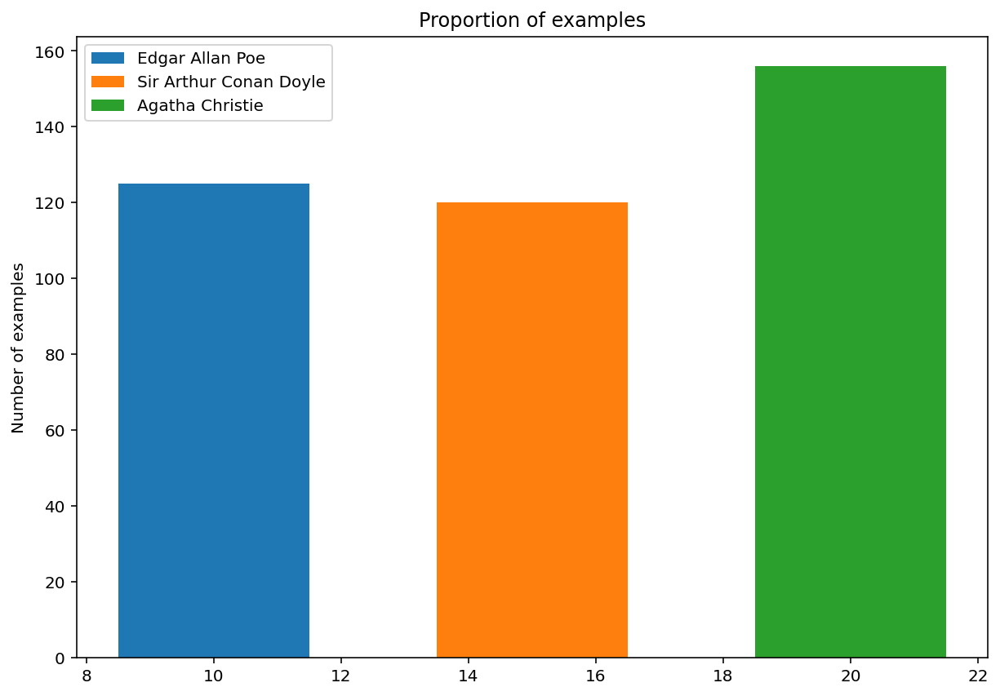

In [5]:
# bar plot of the 3 classes
plt.figure(figsize=(10,7))
plt.bar(10,EAP_len,3, label="Edgar Allan Poe")
plt.bar(15,SACD_len,3, label="Sir Arthur Conan Doyle")
plt.bar(20,AC_len,3, label="Agatha Christie")
plt.legend()
plt.ylabel('Number of examples')
plt.title('Proportion of examples')
plt.show()

## Feature Engineering

### Removing Punctuation

In [6]:
def remove_punctuation(text):
    '''a function for removing punctuation'''
    import string
    # replacing the punctuations with no space, 
    # which in effect deletes the punctuation marks 
    translator = str.maketrans('', '', string.punctuation)
    # return the text stripped of punctuation marks
    return text.translate(translator)

In [7]:
data['text'] = data['text'].apply(remove_punctuation)
data.head(10)

,id,title,text,author
0,1,The Adventures Of Sherlock Holmes,To Sherlock Holmes she is always�the�woman I h...,SACD
1,2,The Adventures Of Sherlock Holmes,I had seen little of Holmes lately My marriage...,SACD
2,3,The Adventures Of Sherlock Holmes,One night it was on the twentieth of March 188...,SACD
3,4,The Adventures Of Sherlock Holmes,His manner was not effusive It seldom was but ...,SACD
4,5,The Adventures Of Sherlock Holmes,Wedlock suits you he remarked I think Watson t...,SACD
5,6,The Adventures Of Sherlock Holmes,Seven I answered,SACD
6,7,The Adventures Of Sherlock Holmes,Indeed I should have thought a little more Jus...,SACD
7,8,The Adventures Of Sherlock Holmes,Then how do you know,SACD
8,9,The Adventures Of Sherlock Holmes,I see it I deduce it How do I know that you ha...,SACD
9,10,The Adventures Of Sherlock Holmes,My dear Holmes said I this is too much You wou...,SACD


### Removing Stopwords

In [8]:
# extracting the stopwords from nltk library
sw = stopwords.words('english')
# displaying the stopwords
np.array(sw)

array(['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you',
       "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself',
       'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her',
       'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them',
       'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom',
       'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are',
       'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had',
       'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and',
       'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at',
       'by', 'for', 'with', 'about', 'against', 'between', 'into',
       'through', 'during', 'before', 'after', 'above', 'below', 'to',
       'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under',
       'again', 'further', 'then', 'once', 'here', 'there', 'when',
       'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'm

In [9]:
print("Number of stopwords: ", len(sw))

Number of stopwords:  179


In [10]:
def stopwords(text):
    '''a function for removing the stopword'''
    # removing the stop words and lowercasing the selected words
    text = [word.lower() for word in text.split() if word.lower() not in sw]
    # joining the list of words with space separator
    return " ".join(text)

In [11]:
data['text'] = data['text'].apply(stopwords)
data.head(10)

,id,title,text,author
0,1,The Adventures Of Sherlock Holmes,sherlock holmes always�the�woman seldom heard ...,SACD
1,2,The Adventures Of Sherlock Holmes,seen little holmes lately marriage drifted us ...,SACD
2,3,The Adventures Of Sherlock Holmes,one night twentieth march 1888 returning journ...,SACD
3,4,The Adventures Of Sherlock Holmes,manner effusive seldom glad think see hardly w...,SACD
4,5,The Adventures Of Sherlock Holmes,wedlock suits remarked think watson put seven ...,SACD
5,6,The Adventures Of Sherlock Holmes,seven answered,SACD
6,7,The Adventures Of Sherlock Holmes,indeed thought little trifle fancy watson prac...,SACD
7,8,The Adventures Of Sherlock Holmes,know,SACD
8,9,The Adventures Of Sherlock Holmes,see deduce know getting wet lately clumsy care...,SACD
9,10,The Adventures Of Sherlock Holmes,dear holmes said much would certainly burned l...,SACD


### Top Words Before Stemming

In [12]:
vec = CountVectorizer().fit(data['text'])
bag_of_words = vec.transform(data['text'])
sum_words = bag_of_words.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
words_freq[:10]

from pandas import DataFrame
Top_10_words = DataFrame (words_freq[:10],columns=['word', 'total'])
Top_10_words

,word,total
0,said,78
1,upon,57
2,one,52
3,would,49
4,man,32
5,dupin,32
6,letter,32
7,well,29
8,prefect,29
9,holmes,26


([<matplotlib.axis.YTick at 0x286d0bdcf70>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

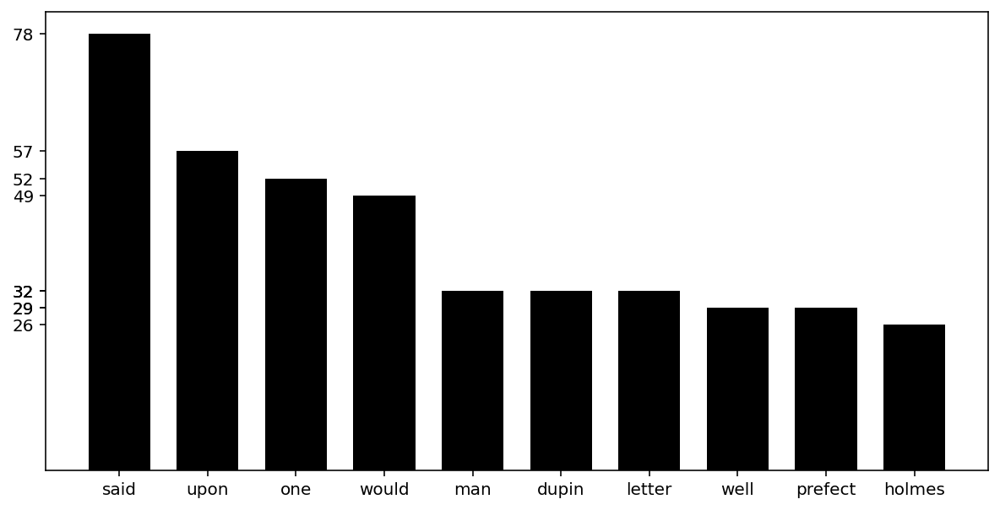

In [13]:
import numpy as np                                                               
import matplotlib.pyplot as plt

#top=[('a',1.875),('c',1.125),('d',0.5)]
words_freq[:10]

labels, ys = zip(*words_freq[:10])
xs = np.arange(len(labels)) 
width = 1

plt.figure(figsize=(10,5))
plt.bar(xs, ys, width=0.7, align='center', color='black')

plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
plt.yticks(ys)

There are 50293 words in the combination of all cells in all books.


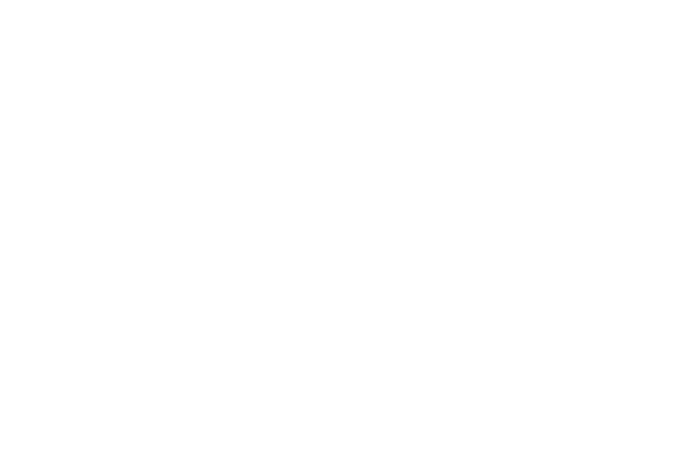

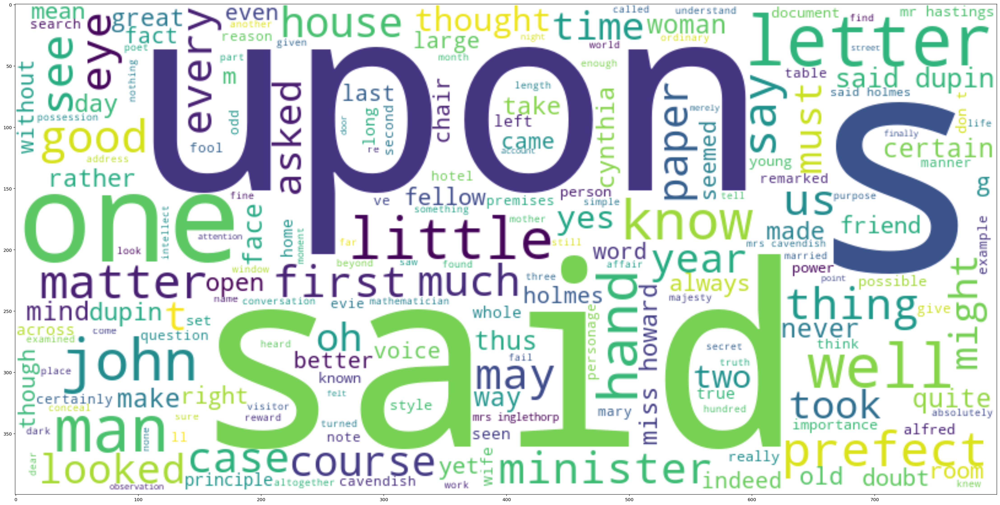

In [14]:
# Python program to generate WordCloud 

# Text of all words in column bloom

text = " ".join(word for word in data['text'])
print ("There are {} words in the combination of all cells in all books.".format(len(text)))

# Generate a word cloud image

wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

### Stemming Operations

In [15]:
# create an object of stemming function
stemmer = SnowballStemmer("english")

def stemming(text):    
    '''a function which stems each word in the given text'''
    text = [stemmer.stem(word) for word in text.split()]
    return " ".join(text) 

In [16]:
data['text'] = data['text'].apply(stemming)
data.head(10)

,id,title,text,author
0,1,The Adventures Of Sherlock Holmes,sherlock holm always�the�woman seldom heard me...,SACD
1,2,The Adventures Of Sherlock Holmes,seen littl holm late marriag drift us away com...,SACD
2,3,The Adventures Of Sherlock Holmes,one night twentieth march 1888 return journey ...,SACD
3,4,The Adventures Of Sherlock Holmes,manner effus seldom glad think see hard word s...,SACD
4,5,The Adventures Of Sherlock Holmes,wedlock suit remark think watson put seven hal...,SACD
5,6,The Adventures Of Sherlock Holmes,seven answer,SACD
6,7,The Adventures Of Sherlock Holmes,inde thought littl trifl fanci watson practic ...,SACD
7,8,The Adventures Of Sherlock Holmes,know,SACD
8,9,The Adventures Of Sherlock Holmes,see deduc know get wet late clumsi careless se...,SACD
9,10,The Adventures Of Sherlock Holmes,dear holm said much would certain burn live ce...,SACD


### Top Words After Stemming

In [17]:
vec = CountVectorizer().fit(data['text'])
bag_of_words = vec.transform(data['text'])
sum_words = bag_of_words.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
words_freq[:10]

from pandas import DataFrame
Top_10_words = DataFrame (words_freq[:10],columns=['word', 'total'])
Top_10_words

,word,total
0,said,78
1,upon,57
2,one,52
3,would,49
4,letter,40
5,man,33
6,dupin,32
7,well,29
8,prefect,29
9,hand,27


([<matplotlib.axis.YTick at 0x286d0f02ac0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

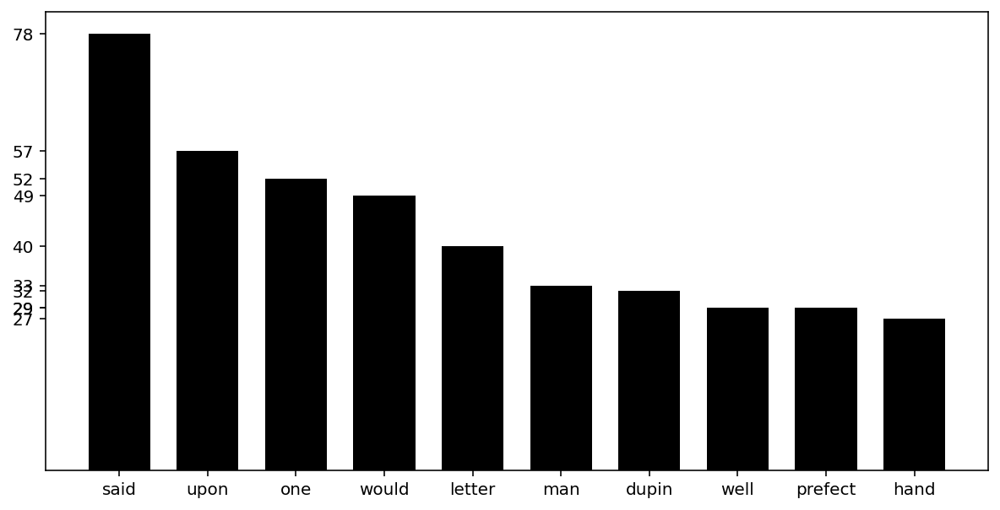

In [18]:
import numpy as np                                                               
import matplotlib.pyplot as plt

#top=[('a',1.875),('c',1.125),('d',0.5)]
words_freq[:10]

labels, ys = zip(*words_freq[:10])
xs = np.arange(len(labels)) 
width = 1

plt.figure(figsize=(10,5))
plt.bar(xs, ys, width=0.7, align='center', color='black')

plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
plt.yticks(ys)

There are 44050 words in the combination of all cells in all books.


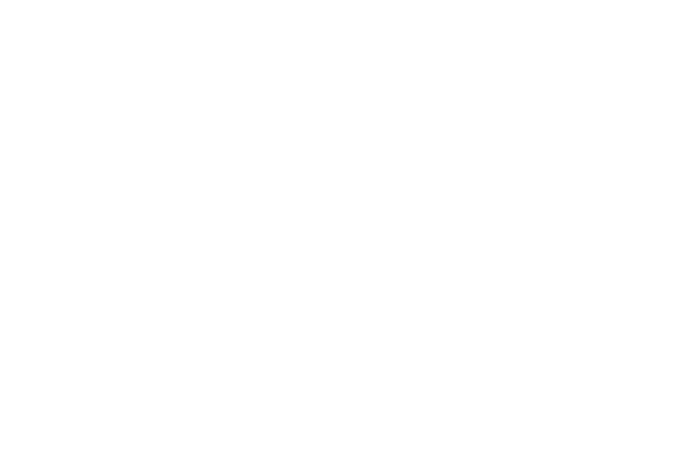

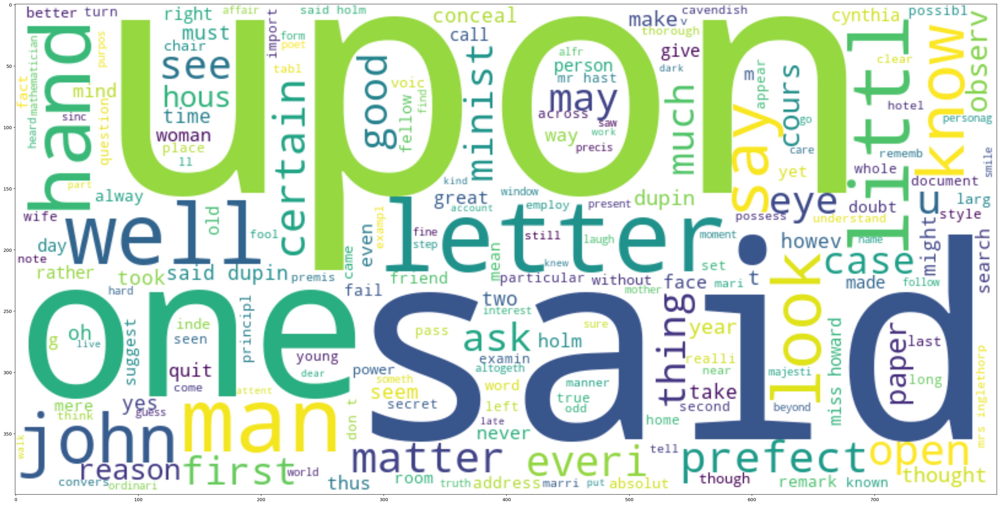

In [19]:
# Python program to generate WordCloud 

# Text of all words in column bloom

text = " ".join(word for word in data['text'])
print ("There are {} words in the combination of all cells in all books.".format(len(text)))

# Generate a word cloud image

wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

### Histogram of text length of each writer

In [20]:
def length(text):    
    '''a function which returns the length of text'''
    return len(text)

In [21]:
data['length'] = data['text'].apply(length)
data.head(10)

,id,title,text,author,length
0,1,The Adventures Of Sherlock Holmes,sherlock holm always�the�woman seldom heard me...,SACD,596
1,2,The Adventures Of Sherlock Holmes,seen littl holm late marriag drift us away com...,SACD,711
2,3,The Adventures Of Sherlock Holmes,one night twentieth march 1888 return journey ...,SACD,506
3,4,The Adventures Of Sherlock Holmes,manner effus seldom glad think see hard word s...,SACD,175
4,5,The Adventures Of Sherlock Holmes,wedlock suit remark think watson put seven hal...,SACD,62
5,6,The Adventures Of Sherlock Holmes,seven answer,SACD,12
6,7,The Adventures Of Sherlock Holmes,inde thought littl trifl fanci watson practic ...,SACD,71
7,8,The Adventures Of Sherlock Holmes,know,SACD,4
8,9,The Adventures Of Sherlock Holmes,see deduc know get wet late clumsi careless se...,SACD,56
9,10,The Adventures Of Sherlock Holmes,dear holm said much would certain burn live ce...,SACD,184


In [22]:
EAP_data = data[data['author'] == 'EAP']
SACD_data = data[data['author'] == 'SACD']
AC_data = data[data['author'] == 'AC']

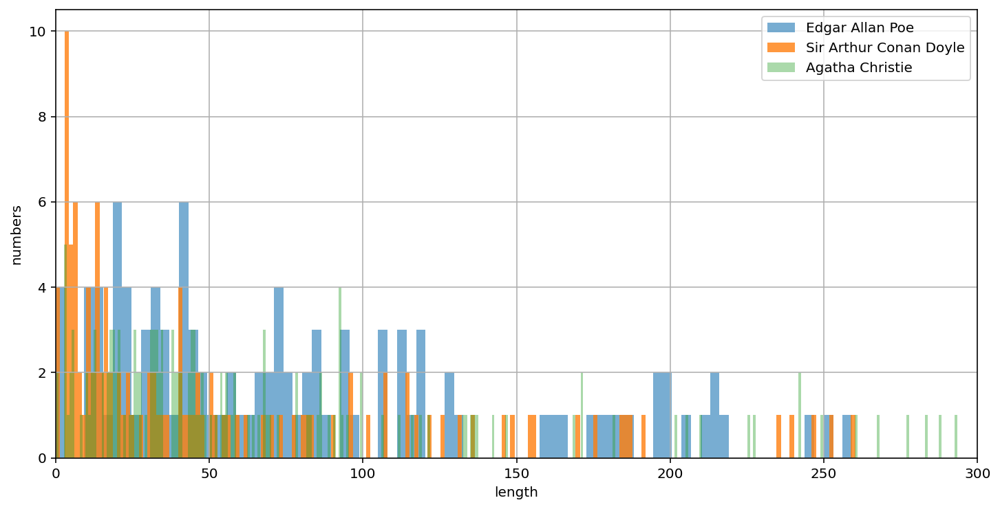

In [23]:
matplotlib.rcParams['figure.figsize'] = (12.0, 6.0)
bins = 500
plt.hist(EAP_data['length'], alpha = 0.6, bins=bins, label='Edgar Allan Poe')
plt.hist(SACD_data['length'], alpha = 0.8, bins=bins, label='Sir Arthur Conan Doyle')
plt.hist(AC_data['length'], alpha = 0.4, bins=bins, label='Agatha Christie')
plt.xlabel('length')
plt.ylabel('numbers')
plt.legend(loc='upper right')
plt.xlim(0,300)
plt.grid()
plt.show()

## Top Words Of Each Writer

### Edgar Allan Poe

In [24]:
vec = CountVectorizer().fit(EAP_data['text'])
bag_of_words = vec.transform(EAP_data['text'])
sum_words = bag_of_words.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
words_freq[:10]

from pandas import DataFrame
Top_10_words = DataFrame (words_freq[:10],columns=['word', 'total'])
Top_10_words

,word,total
0,said,43
1,upon,40
2,letter,36
3,would,33
4,dupin,32
5,prefect,29
6,one,26
7,minist,19
8,well,17
9,open,15


([<matplotlib.axis.YTick at 0x286d181de50>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

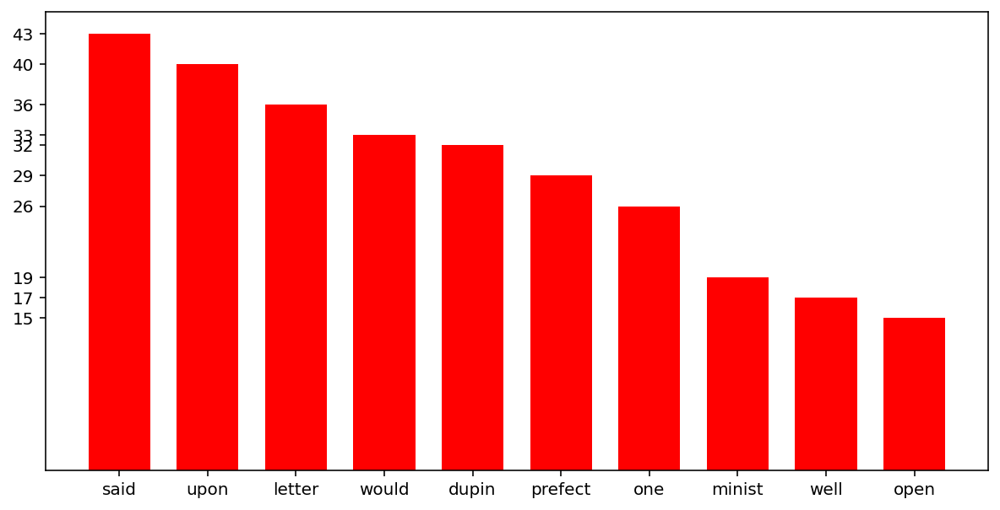

In [25]:
import numpy as np                                                               
import matplotlib.pyplot as plt

#top=[('a',1.875),('c',1.125),('d',0.5)]
words_freq[:10]

labels, ys = zip(*words_freq[:10])
xs = np.arange(len(labels)) 
width = 1

plt.figure(figsize=(10,5))
plt.bar(xs, ys, width=0.7, align='center', color='red')

plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
plt.yticks(ys)

There are 21251 words in the combination of all cells in all books.


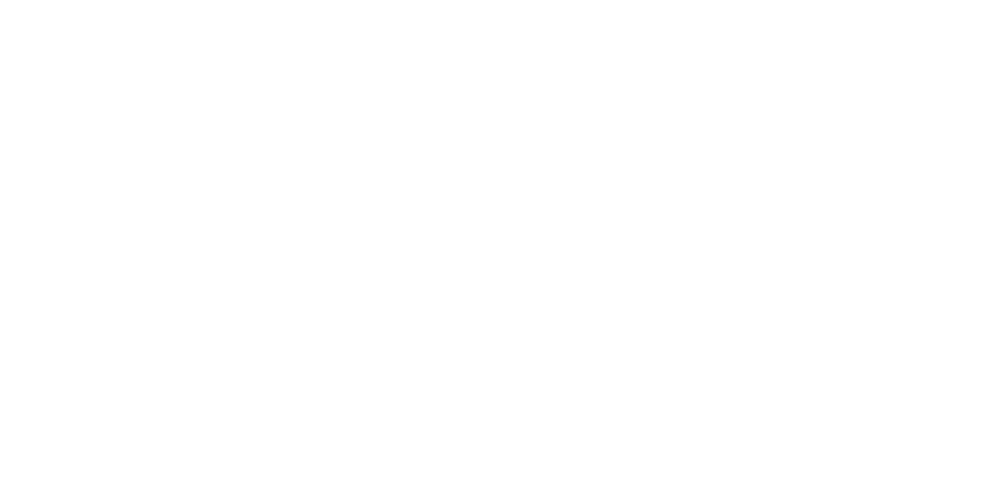

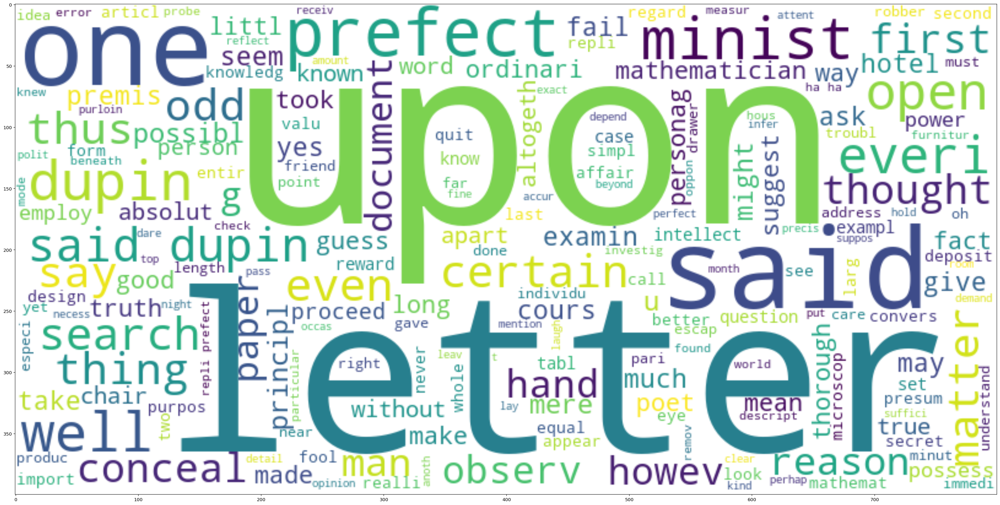

In [26]:
# Python program to generate WordCloud 

# Text of all words in column bloom

text = " ".join(word for word in EAP_data['text'])
print ("There are {} words in the combination of all cells in all books.".format(len(text)))

# Generate a word cloud image

wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

### Sir Arthur Conan Doyle

In [27]:
vec = CountVectorizer().fit(SACD_data['text'])
bag_of_words = vec.transform(SACD_data['text'])
sum_words = bag_of_words.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
words_freq[:10]

from pandas import DataFrame
Top_10_words = DataFrame (words_freq[:10],columns=['word', 'total'])
Top_10_words

,word,total
0,holm,24
1,said,21
2,one,15
3,upon,15
4,would,11
5,may,11
6,eye,9
7,know,9
8,matter,9
9,man,8


([<matplotlib.axis.YTick at 0x286d103a8e0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

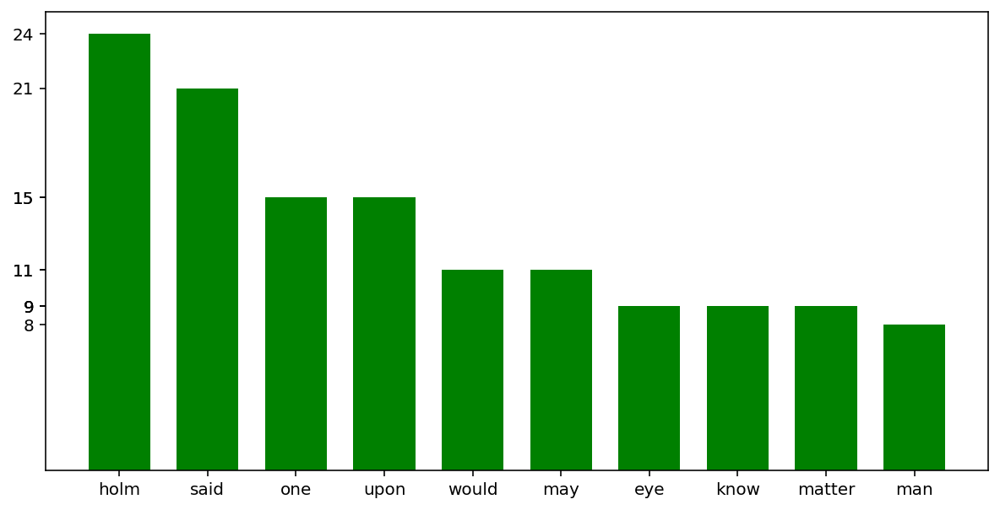

In [28]:
import numpy as np                                                               
import matplotlib.pyplot as plt

#top=[('a',1.875),('c',1.125),('d',0.5)]
words_freq[:10]

labels, ys = zip(*words_freq[:10])
xs = np.arange(len(labels)) 
width = 1

plt.figure(figsize=(10,5))
plt.bar(xs, ys, width=0.7, align='center', color='green')

plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
plt.yticks(ys)

There are 9897 words in the combination of all cells in all books.


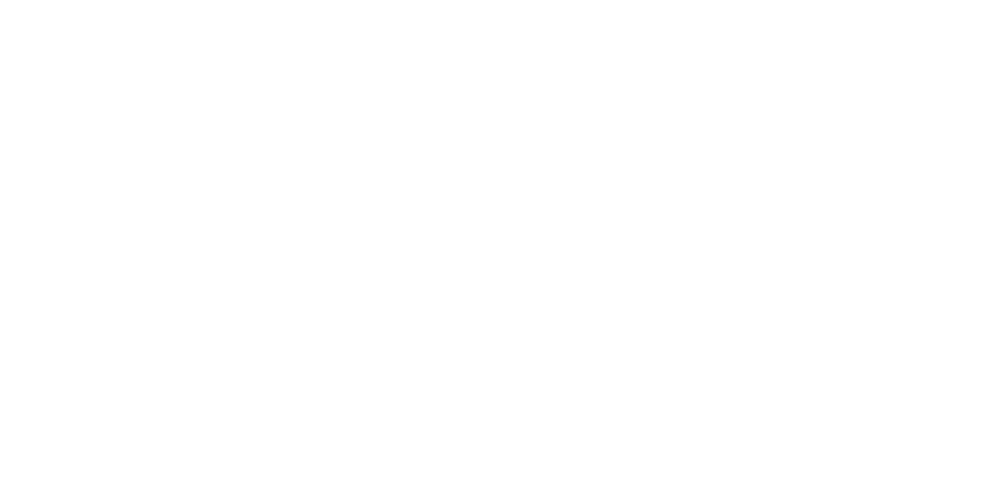

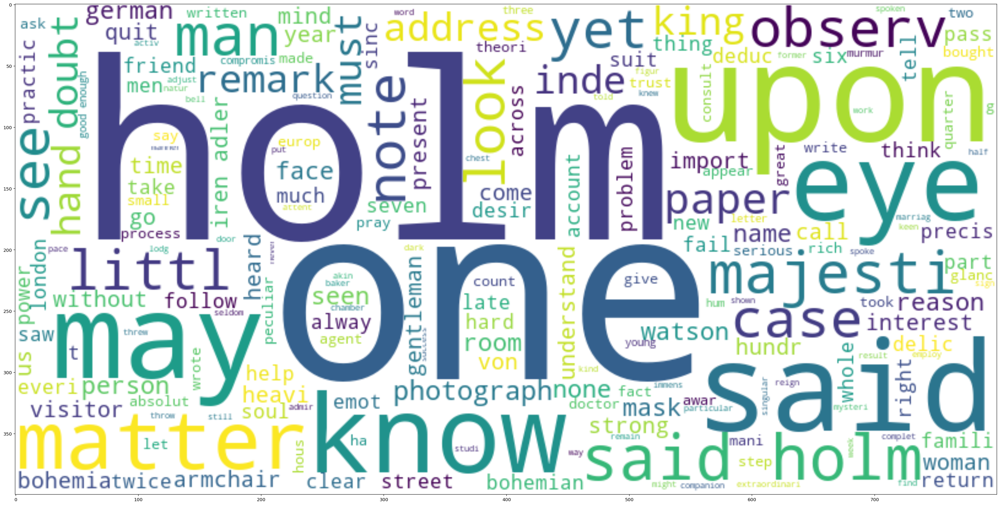

In [29]:
# Python program to generate WordCloud 

# Text of all words in column bloom

text = " ".join(word for word in SACD_data['text'])
print ("There are {} words in the combination of all cells in all books.".format(len(text)))

# Generate a word cloud image

wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

### Agatha Christie

In [30]:
vec = CountVectorizer().fit(AC_data['text'])
bag_of_words = vec.transform(AC_data['text'])
sum_words = bag_of_words.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in     vec.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
words_freq[:10]

from pandas import DataFrame
Top_10_words = DataFrame (words_freq[:10],columns=['word', 'total'])
Top_10_words

,word,total
0,john,25
1,mrs,18
2,cavendish,16
3,howard,16
4,hast,15
5,miss,15
6,said,14
7,you,13
8,inglethorp,13
9,cynthia,13


([<matplotlib.axis.YTick at 0x286d0ce02b0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

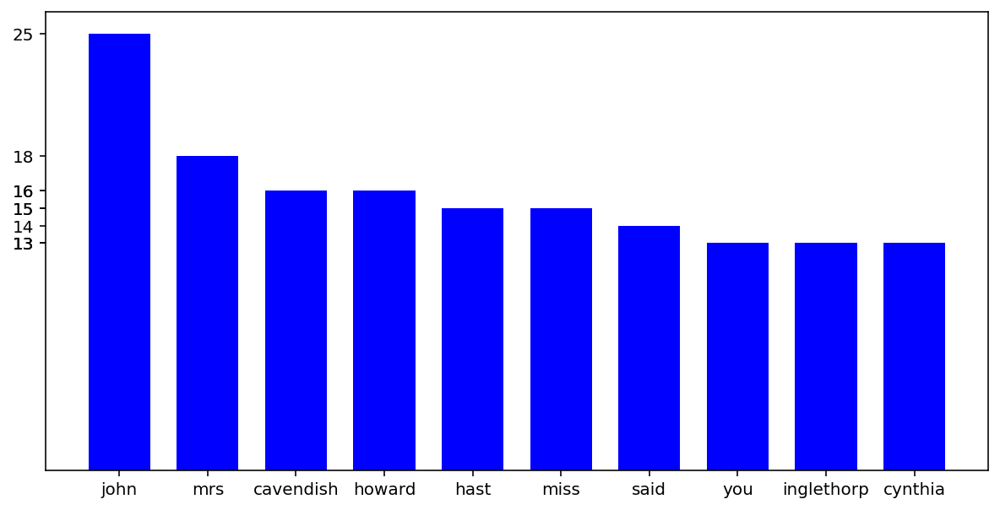

In [31]:
import numpy as np                                                               
import matplotlib.pyplot as plt

#top=[('a',1.875),('c',1.125),('d',0.5)]
words_freq[:10]

labels, ys = zip(*words_freq[:10])
xs = np.arange(len(labels)) 
width = 1

plt.figure(figsize=(10,5))
plt.bar(xs, ys, width=0.7, align='center', color='blue')

plt.xticks(xs, labels) #Replace default x-ticks with xs, then replace xs with labels
plt.yticks(ys)

There are 12900 words in the combination of all cells in all books.


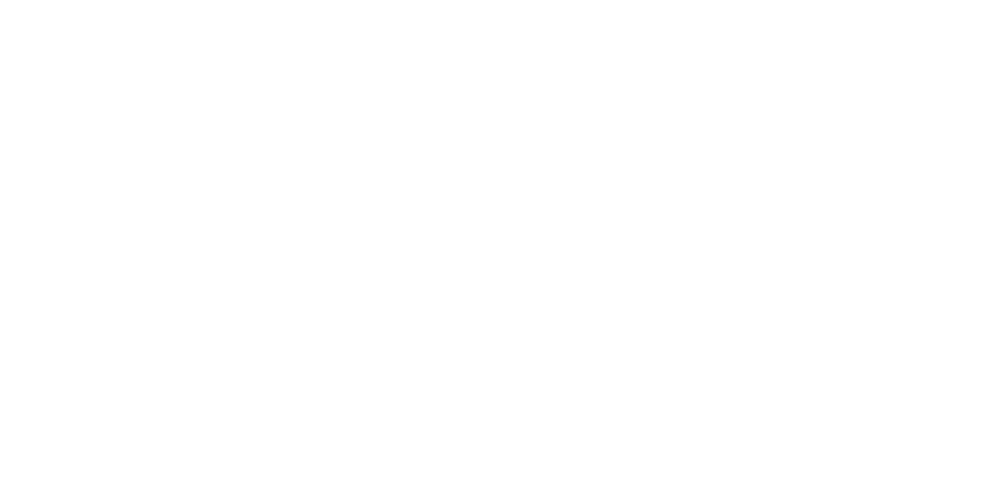

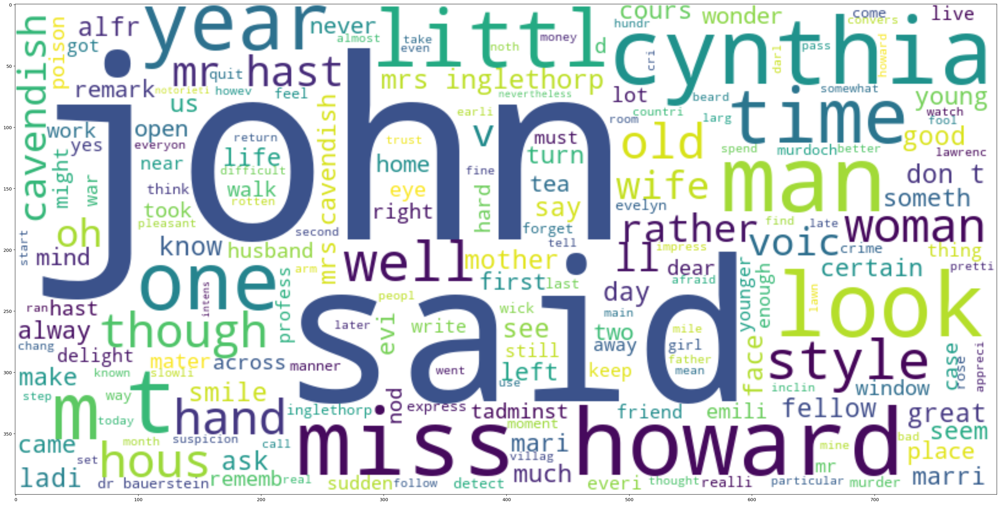

In [32]:
# Python program to generate WordCloud 

# Text of all words in column bloom

text = " ".join(word for word in AC_data['text'])
print ("There are {} words in the combination of all cells in all books.".format(len(text)))

# Generate a word cloud image

wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

## TF-IDF Extraction

In [33]:
# create the object of tfid vectorizer
tfid_vectorizer = TfidfVectorizer("english")
# fit the vectorizer using the text data
tfid_vectorizer.fit(data['text'])
# collect the vocabulary items used in the vectorizer
dictionary = tfid_vectorizer.vocabulary_.items()  
# extract the tfid representation matrix of the text data
tfid_matrix = tfid_vectorizer.transform(data['text'])
# collect the tfid matrix in numpy array
array = tfid_matrix.todense()

C:\Users\Irfan\anaconda3\lib\site-packages\sklearn\utils\validation.py:67: FutureWarning: Pass input=english as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


In [53]:
# store the tf-idf array into pandas dataframe
df = pd.DataFrame(array)
df

,0,1,2,3,4,5,6,7,8,9,...,2335,2336,2337,2338,2339,2340,2341,2342,2343,2344
0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.106431,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.076177,0.0,0.0,0.0,0.0
1,0.0,0.0,0.000000,0.0,0.100946,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
2,0.0,0.0,0.121143,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
3,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
4,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
397,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
398,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
399,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0


### Training Model

In [35]:
df['output'] = data['author']
df['id'] = data['id']
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,2337,2338,2339,2340,2341,2342,2343,2344,output,id
0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.106431,0.0,0.0,...,0.0,0.0,0.0,0.076177,0.0,0.0,0.0,0.0,SACD,1
1,0.0,0.0,0.000000,0.0,0.100946,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,2
2,0.0,0.0,0.121143,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,3
3,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,4
4,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,5
5,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,6
6,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,7
7,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,8
8,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,9
9,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,SACD,10


In [36]:
features = df.columns.tolist()
output = 'output'
# removing the output and the id from features
features.remove(output)
features.remove('id')

In [37]:
from sklearn.naive_bayes import GaussianNB, BernoulliNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, log_loss
from sklearn.model_selection import GridSearchCV

### Tuning Multinomial Naive Bayes Classifier

In [38]:
alpha_list1 = np.linspace(0.006, 0.1, 20)
alpha_list1 = np.around(alpha_list1, decimals=4)
alpha_list1

array([0.006 , 0.0109, 0.0159, 0.0208, 0.0258, 0.0307, 0.0357, 0.0406,
       0.0456, 0.0505, 0.0555, 0.0604, 0.0654, 0.0703, 0.0753, 0.0802,
       0.0852, 0.0901, 0.0951, 0.1   ])

In [39]:
# parameter grid
parameter_grid = [{"alpha":alpha_list1}]

In [40]:
# classifier object
classifier1 = MultinomialNB()
# gridsearch object using 4 fold cross validation and neg_log_loss as scoring paramter
gridsearch1 = GridSearchCV(classifier1,parameter_grid, scoring = 'neg_log_loss', cv = 4)
# fit the gridsearch
gridsearch1.fit(df[features], df[output])

GridSearchCV(cv=4, estimator=MultinomialNB(),
             param_grid=[{'alpha': array([0.006 , 0.0109, 0.0159, 0.0208, 0.0258, 0.0307, 0.0357, 0.0406,
       0.0456, 0.0505, 0.0555, 0.0604, 0.0654, 0.0703, 0.0753, 0.0802,
       0.0852, 0.0901, 0.0951, 0.1   ])}],
             scoring='neg_log_loss')

In [41]:
results1 = pd.DataFrame()
# collect alpha list
results1['alpha'] = gridsearch1.cv_results_['param_alpha'].data
# collect test scores
results1['neglogloss'] = gridsearch1.cv_results_['mean_test_score'].data

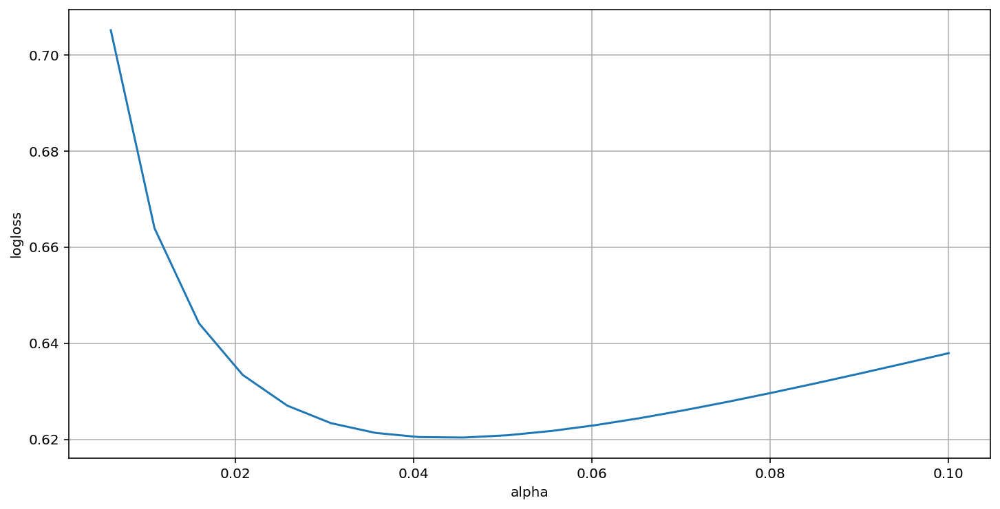

In [42]:
matplotlib.rcParams['figure.figsize'] = (12.0, 6.0)
plt.plot(results1['alpha'], -results1['neglogloss'])
plt.xlabel('alpha')
plt.ylabel('logloss')
plt.grid()

In [43]:
print("Best parameter: ",gridsearch1.best_params_)

Best parameter:  {'alpha': 0.0456}


In [44]:
print("Best score: ",gridsearch1.best_score_) 

Best score:  -0.6203875916908509


### Tuning Multinomial Naive Bayes Classifier

In [45]:
alpha_list2 = np.linspace(0.006, 0.1, 20)
alpha_list2 = np.around(alpha_list2, decimals=4)
alpha_list2

array([0.006 , 0.0109, 0.0159, 0.0208, 0.0258, 0.0307, 0.0357, 0.0406,
       0.0456, 0.0505, 0.0555, 0.0604, 0.0654, 0.0703, 0.0753, 0.0802,
       0.0852, 0.0901, 0.0951, 0.1   ])

In [46]:
parameter_grid = [{"alpha":alpha_list2}]

In [47]:
# classifier object
classifier2 = MultinomialNB()
# gridsearch object using 4 fold cross validation and neg_log_loss as scoring paramter
gridsearch2 = GridSearchCV(classifier2,parameter_grid, scoring = 'neg_log_loss', cv = 4)
# fit the gridsearch
gridsearch2.fit(df[features], df[output])

GridSearchCV(cv=4, estimator=MultinomialNB(),
             param_grid=[{'alpha': array([0.006 , 0.0109, 0.0159, 0.0208, 0.0258, 0.0307, 0.0357, 0.0406,
       0.0456, 0.0505, 0.0555, 0.0604, 0.0654, 0.0703, 0.0753, 0.0802,
       0.0852, 0.0901, 0.0951, 0.1   ])}],
             scoring='neg_log_loss')

In [48]:
# classifier object
classifier2 = MultinomialNB()
# gridsearch object using 4 fold cross validation and neg_log_loss as scoring paramter
gridsearch2 = GridSearchCV(classifier2,parameter_grid, scoring = 'neg_log_loss', cv = 4)
# fit the gridsearch
gridsearch2.fit(df[features], df[output])

GridSearchCV(cv=4, estimator=MultinomialNB(),
             param_grid=[{'alpha': array([0.006 , 0.0109, 0.0159, 0.0208, 0.0258, 0.0307, 0.0357, 0.0406,
       0.0456, 0.0505, 0.0555, 0.0604, 0.0654, 0.0703, 0.0753, 0.0802,
       0.0852, 0.0901, 0.0951, 0.1   ])}],
             scoring='neg_log_loss')

In [49]:
results2 = pd.DataFrame()
# collect alpha list
results2['alpha'] = gridsearch2.cv_results_['param_alpha'].data
# collect test scores
results2['neglogloss'] = gridsearch2.cv_results_['mean_test_score'].data

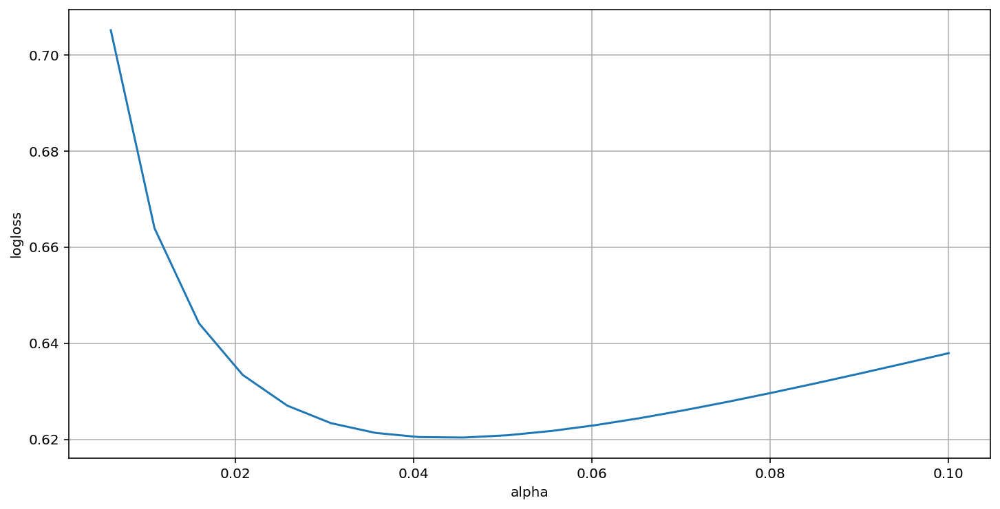

In [50]:
matplotlib.rcParams['figure.figsize'] = (12.0, 6.0)
plt.plot(results2['alpha'], -results2['neglogloss'])
plt.xlabel('alpha')
plt.ylabel('logloss')
plt.grid()

In [51]:
print("Best parameter: ",gridsearch2.best_params_)

Best parameter:  {'alpha': 0.0456}


In [52]:
print("Best score: ",gridsearch2.best_score_)

Best score:  -0.6203875916908509
